In [7]:
import numpy as np
import matplotlib.pyplot as plt
import importlib
import lab1_proto as pr

# 3.Data

In [8]:
data = np.load("lab1_data.npz", allow_pickle=True)['data']  
example = np.load("lab1_example.npz", allow_pickle=True)['example'].item()

In [9]:
data[0].keys()

dict_keys(['filename', 'samplingrate', 'gender', 'speaker', 'digit', 'repetition', 'samples'])

In [10]:
example.keys()

dict_keys(['samples', 'samplingrate', 'frames', 'preemph', 'windowed', 'spec', 'mspec', 'mfcc', 'lmfcc'])

# 4.Mel Frequency Cepstrum Coefficients step-by-step

## 4.1 Enframe

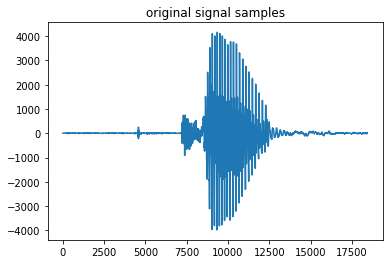

Sampling Rate 20000


In [19]:
plt.figure()
plt.plot(example['samples'])
plt.title('original signal samples')
plt.show()

print('Sampling Rate', example['samplingrate'])

In [23]:
winlen_sec, winshift_sec = 0.02, 0.01
winlen, winshift = int(example['samplingrate'] * winlen_sec), int(example['samplingrate'] * winshift_sec)
print("winlen", winlen, "winshift", winshift)

winlen 400 winshift 200


Text(0.5, 1.0, 'example')

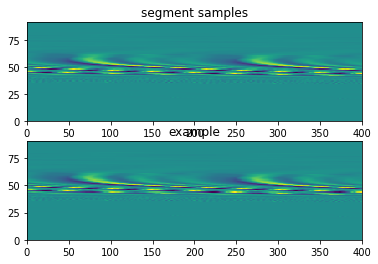

In [24]:
importlib.reload(pr)
frames = pr.enframe(example['samples'],winlen=winlen,winshift=winshift)

plt.figure()
plt.subplot(2,1,1)
plt.pcolormesh(frames)
plt.title('segment samples')
plt.subplot(2,1,2)
plt.pcolormesh(example['frames'])
plt.title('example')

In [29]:
print("Mean diff between example frames and our frames:", np.mean(frames - example['frames']))

Mean diff between example frames and our frames: 0.0


## 4.2 Pre-emphasis

Text(0.5, 1.0, 'preemph example')

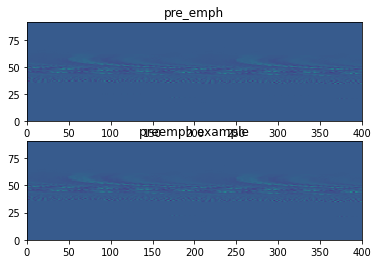

In [35]:
importlib.reload(pr)

pre_emph = pr.preemp(frames)

plt.figure()
plt.subplot(2,1,1)
plt.pcolormesh(pre_emph)
plt.title('pre_emph')
plt.subplot(2,1,2)
plt.pcolormesh(example['preemph'])
plt.title('preemph example')


In [34]:
print("Mean diff between example preemp and our preemp:", np.mean(pre_emp - example['preemph']))

Mean diff between example preemp and our preemp: 0.0


## 4.3 Hamming Window